In [2]:
# Installing and importing important packages
!apt-get install abcmidi timidity > /dev/null 2>&1
!pip install mitdeeplearning --quiet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 59.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 149.3/149.3 kB 14.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 491.2/491.2 kB 37.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 438.6/438.6 kB 32.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 68.6/68.6 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 12.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 183.9/183.9 kB 18.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 161.7/161.7 kB 15.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.5/143.5 kB 15.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 75.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 84.7 MB/s eta 0:0

In [5]:
import torch
import torch.nn as nn
import torch.optim as optim

import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
from scipy.io.wavfile import write

import mitdeeplearning as mdl

In [6]:
# Download the dataset
songs = mdl.lab1.load_training_data()

# Print one of the songs
example_song = songs[0]
print("\nExample song: ")
print(example_song)

Found 817 songs in text

Example song: 
X:1
T:Alexander's
Z: id:dc-hornpipe-1
M:C|
L:1/8
K:D Major
(3ABc|dAFA DFAd|fdcd FAdf|gfge fefd|(3efe (3dcB A2 (3ABc|!
dAFA DFAd|fdcd FAdf|gfge fefd|(3efe dc d2:|!
AG|FAdA FAdA|GBdB GBdB|Acec Acec|dfaf gecA|!
FAdA FAdA|GBdB GBdB|Aceg fefd|(3efe dc d2:|!


In [7]:
# Convert the ABC notation to audio file and listening
mdl.lab1.play_song(example_song)

In [8]:
# Join our list of song strings into a single string containing all songs
songs_joined = "\n\n".join(songs)

# Find all unique characters in the joined string
vocab = sorted(set(songs_joined))
print("There are", len(vocab), "unique characters in the dataset")

There are 83 unique characters in the dataset


In [9]:
### Define numerical representation of text ###

# Create a mapping from character to unique index.
# For example, to get the index of the character "d",
#   we can evaluate `char2idx["d"]`.
char2idx = {u: i for i, u in enumerate(vocab)}

# Create a mapping from indices to characters. This is
#   the inverse of char2idx and allows us to convert back
#   from unique index to the character in our vocabulary.
idx2char = np.array(vocab)

In [10]:
print('{')
for char, _ in zip(char2idx, range(20)):
    print('  {:4s}: {:3d},'.format(repr(char), char2idx[char]))
print('  ...\n}')

{
  '\n':   0,
  ' ' :   1,
  '!' :   2,
  '"' :   3,
  '#' :   4,
  "'" :   5,
  '(' :   6,
  ')' :   7,
  ',' :   8,
  '-' :   9,
  '.' :  10,
  '/' :  11,
  '0' :  12,
  '1' :  13,
  '2' :  14,
  '3' :  15,
  '4' :  16,
  '5' :  17,
  '6' :  18,
  '7' :  19,
  ...
}


In [11]:
### Vectorize the songs string ###
def vectorize_string(string):
  vectorized_output = np.array([char2idx[char] for char in string])
  return vectorized_output

vectorized_songs = vectorize_string(songs_joined)

In [12]:
print ('{} ---- characters mapped to int ----> {}'.format(repr(songs_joined[:10]), vectorized_songs[:10]))
# check that vectorized_songs is a numpy array
assert isinstance(vectorized_songs, np.ndarray), "returned result should be a numpy array"

'X:1\nT:Alex' ---- characters mapped to int ----> [49 22 13  0 45 22 26 67 60 79]


In [13]:
### Batch definition to create training examples ###

def get_batch(vectorized_songs, seq_length, batch_size):
    # the length of the vectorized songs string
    n = vectorized_songs.shape[0] - 1
    # randomly choose the starting indices for the examples in the training batch
    idx = np.random.choice(n - seq_length, batch_size)

    # construct a list of input sequences for the training batch
    input_batch = [vectorized_songs[i: i+seq_length] for i in idx]

    # construct a list of output sequences for the training batch
    output_batch = [vectorized_songs[i+1: i+seq_length+1] for i in idx]

    # Convert the input and output batches to tensors
    x_batch = torch.tensor(input_batch, dtype=torch.long)
    y_batch = torch.tensor(output_batch, dtype=torch.long)

    return x_batch, y_batch

# Perform some simple tests to make sure your batch function is working properly!
test_args = (vectorized_songs, 10, 2)
x_batch, y_batch = get_batch(*test_args)
assert x_batch.shape == (2, 10), "x_batch shape is incorrect"
assert y_batch.shape == (2, 10), "y_batch shape is incorrect"
print("Batch function works correctly!")

Batch function works correctly!


<ipython-input-13-654b9bceb326>:16: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at /pytorch/torch/csrc/utils/tensor_new.cpp:254.)
  x_batch = torch.tensor(input_batch, dtype=torch.long)


In [14]:
x_batch, y_batch = get_batch(vectorized_songs, seq_length=5, batch_size=1)

for i, (input_idx, target_idx) in enumerate(zip(x_batch[0], y_batch[0])):
    print("Step {:3d}".format(i))
    print("  input: {} ({:s})".format(input_idx, repr(idx2char[input_idx.item()])))
    print("  expected output: {} ({:s})".format(target_idx, repr(idx2char[target_idx.item()])))

Step   0
  input: 61 (np.str_('f'))
  expected output: 82 (np.str_('|'))
Step   1
  input: 82 (np.str_('|'))
  expected output: 59 (np.str_('d'))
Step   2
  input: 59 (np.str_('d'))
  expected output: 27 (np.str_('B'))
Step   3
  input: 27 (np.str_('B'))
  expected output: 26 (np.str_('A'))
Step   4
  input: 26 (np.str_('A'))
  expected output: 1 (np.str_(' '))


In [15]:
# Defining the RNN model
class LSTMModel(nn.Module):
  def __init__(self, vocab_size, embedding_dim, hidden_size):
        super(LSTMModel, self).__init__()
        self.hidden_size = hidden_size

        # Define each of the network layers
        # Layer 1: Embedding layer to transform indices into dense vectors
        #   of a fixed embedding size
        self.embedding = nn.Embedding(vocab_size, embedding_dim)

        # Layer 2: LSTM with hidden_size `hidden_size`. note: number of layers defaults to 1.
        # Use the nn.LSTM() module from pytorch.
        self.lstm = nn.LSTM(embedding_dim, hidden_size, batch_first=True)

        # Layer 3: Linear (fully-connected) layer that transforms the LSTM output into the vocabulary size.
        self.fc = nn.Linear(hidden_size, vocab_size) # TODO

  def init_hidden(self, batch_size, device):
      # Initialize hidden state and cell state with zeros
      return (torch.zeros(1, batch_size, self.hidden_size).to(device),
              torch.zeros(1, batch_size, self.hidden_size).to(device))

  def forward(self, x, state=None, return_state=False):
      x = self.embedding(x)

      if state is None:
          state = self.init_hidden(x.size(0), x.device)
      out, state = self.lstm(x, state)

      out = self.fc(out)
      return out if not return_state else (out, state)

In [16]:
# Instantiate the model! Build a simple model with default hyperparameters. You
#     will get the chance to change these later.
vocab_size = len(vocab)
embedding_dim = 256
hidden_size = 1024
batch_size = 8

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = LSTMModel(vocab_size, embedding_dim, hidden_size).to(device)

# print out a summary of the model
print(model)

LSTMModel(
  (embedding): Embedding(83, 256)
  (lstm): LSTM(256, 1024, batch_first=True)
  (fc): Linear(in_features=1024, out_features=83, bias=True)
)


In [17]:
# Test the model with some sample data
x, y = get_batch(vectorized_songs, seq_length=100, batch_size=32)
x = x.to(device)
y = y.to(device)

pred = model(x)
print("Input shape:      ", x.shape, " # (batch_size, sequence_length)")
print("Prediction shape: ", pred.shape, "# (batch_size, sequence_length, vocab_size)")

Input shape:       torch.Size([32, 100])  # (batch_size, sequence_length)
Prediction shape:  torch.Size([32, 100, 83]) # (batch_size, sequence_length, vocab_size)


In [18]:
sampled_indices = torch.multinomial(torch.softmax(pred[0], dim=-1), num_samples=1)
sampled_indices = sampled_indices.squeeze(-1).cpu().numpy()
sampled_indices

array([74, 49, 71, 45, 26, 50,  5, 37,  3, 64, 79, 76,  4, 39, 56, 79, 41,
       48, 27, 28, 25, 17, 46, 14, 47, 73, 46, 64, 73, 26, 13, 72, 62,  3,
       72, 24,  2,  9, 79, 72, 63, 37, 20,  2,  8, 19, 33, 52, 71, 36, 30,
        2, 27, 75, 70, 13,  3, 14, 38,  6, 69, 30, 20, 54, 60, 68,  0, 23,
       67, 31,  3, 73, 35,  5, 26, 16, 40, 64, 20,  6, 77, 17, 75, 21, 48,
       66, 17, 81, 18, 10, 12, 49, 12, 62, 71, 50, 48, 22, 17, 50])

In [19]:
print("Input: \n", repr("".join(idx2char[x[0].cpu()])))
print()
print("Next Char Predictions: \n", repr("".join(idx2char[sampled_indices])))

Input: 
 'E2:|!\n\nX:161\nT:Trip to the Cottage\nZ: id:dc-jig-138\nM:6/8\nL:1/8\nK:G Major\nzB|ded BGB|cBc AFE|DGG FGA'

Next Char Predictions: 
 'sXpTAY\'L"ixu#NaxPWBC>5U2VrUirA1qg"q=!-xqhL8!,7H[pKE!Bto1"2M(nE8^em\n<lF"rJ\'A4Oi8(v5t9Wk5z6.0X0gpYW:5Y'


In [20]:
### Defining the loss function ###

# define the compute_loss function to compute and return the loss between
# the true labels and predictions (logits).
cross_entropy = nn.CrossEntropyLoss() # instantiates the function
def compute_loss(labels, logits):
    """
    Inputs:
      labels: (batch_size, sequence_length)
      logits: (batch_size, sequence_length, vocab_size)

    Output:
      loss: scalar cross entropy loss over the batch and sequence length
    """

    # Batch the labels so that the shape of the labels should be (B * L,)
    batched_labels = labels.view(-1)

    # Batch the logits so that the shape of the logits should be (B * L, V)
    batched_logits = logits.view(-1, logits.size(-1))

    # Compute the cross-entropy loss using the batched  next characters and predictions
    loss = cross_entropy(batched_logits, batched_labels)
    return loss

In [21]:
### compute the loss on the predictions from the untrained model from earlier. ###
y.shape  # (batch_size, sequence_length)
pred.shape  # (batch_size, sequence_length, vocab_size)

# compute the loss using the true next characters from the example batch
# and the predictions from the untrained model several cells above
example_batch_loss = compute_loss(y, pred)

print(f"Prediction shape: {pred.shape} # (batch_size, sequence_length, vocab_size)")
print(f"scalar_loss:      {example_batch_loss.mean().item()}")

Prediction shape: torch.Size([32, 100, 83]) # (batch_size, sequence_length, vocab_size)
scalar_loss:      4.426677227020264


In [22]:
### Hyperparameter setting and optimization ###

vocab_size = len(vocab)

# Model parameters:
params = dict(
  num_training_iterations = 3000,  # Increase this to train longer
  batch_size = 8,  # Experiment between 1 and 64
  seq_length = 100,  # Experiment between 50 and 500
  learning_rate = 5e-3,  # Experiment between 1e-5 and 1e-1
  embedding_dim = 256,
  hidden_size = 1024,  # Experiment between 1 and 2048
)

# Checkpoint location:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")
os.makedirs(checkpoint_dir, exist_ok=True)

In [24]:
### Define optimizer and training operation ###

# instantiate a new LSTMModel model for training using the hyperparameters created above.
model = LSTMModel(vocab_size, embedding_dim, hidden_size)

# Move the model to the GPU
model.to(device)

# instantiate an optimizer with its learning rate.
# Checkout the PyTorch website for a list of supported optimizers.
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

def train_step(x, y):
  # Set the model's mode to train
  model.train()

  # Zero gradients for every step
  optimizer.zero_grad()

  # Forward pass
  # feed the current input into the model and generate predictions
  y_hat = model(x)

  # Compute the loss
  loss = compute_loss(y, y_hat)

  # Backward pass
  loss.backward()  # Backpropagate the loss
  optimizer.step()  # Update model parameters

  return loss

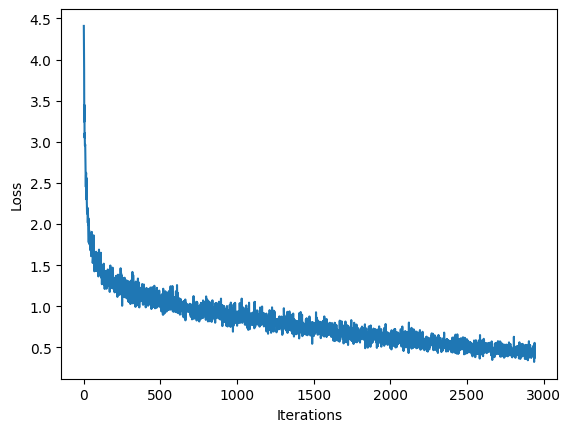

100%|██████████| 3000/3000 [01:27<00:00, 34.47it/s]


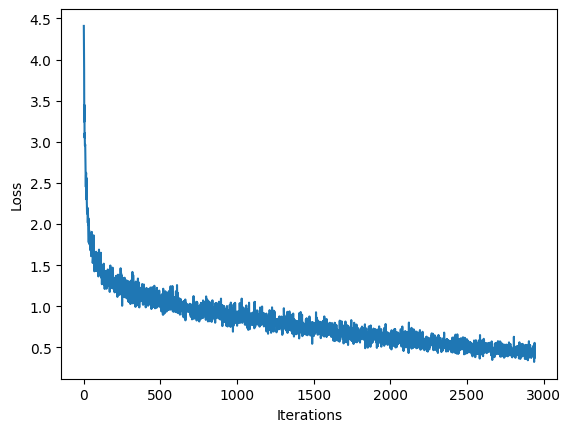

In [25]:
##################
# Begin training!#
##################

history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
# experiment = create_experiment()

if hasattr(tqdm, '_instances'): tqdm._instances.clear() # clear if it exists
for iter in tqdm(range(params["num_training_iterations"])):

    # Grab a batch and propagate it through the network
    x_batch, y_batch = get_batch(vectorized_songs, params["seq_length"], params["batch_size"])

    # Convert numpy arrays to PyTorch tensors
    x_batch = torch.tensor(x_batch, dtype=torch.long).to(device)
    y_batch = torch.tensor(y_batch, dtype=torch.long).to(device)

    # Take a train step
    loss = train_step(x_batch, y_batch)

    # Log the loss to the Comet interface
    # experiment.log_metric("loss", loss.item(), step=iter)

    # Update the progress bar and visualize within notebook
    history.append(loss.item())
    plotter.plot(history)

    # Save model checkpoint
    if iter % 100 == 0:
        torch.save(model.state_dict(), checkpoint_prefix)

# Save the final trained model
torch.save(model.state_dict(), checkpoint_prefix)
# experiment.flush()

In [26]:
### Prediction of a generated song ###

def generate_text(model, start_string, generation_length=1000):
  # Evaluation step (generating ABC text using the learned RNN model)

  # convert the start string to numbers (vectorize)
  input_idx = vectorize_string(start_string)
  # print(input_idx)
  input_idx = torch.tensor([input_idx], dtype=torch.long).to(device)

  # Initialize the hidden state
  state = model.init_hidden(input_idx.size(0), device)

  # Empty string to store our results
  text_generated = []
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
    # evaluate the inputs and generate the next character predictions
    predictions, hidden_state = model(input_idx, state, return_state=True)

    # Remove the batch dimension
    predictions = predictions.squeeze(0)

    # use a multinomial distribution to sample over the probabilities
    probs = torch.softmax(predictions, dim=-1)
    input_idx = torch.multinomial(probs, num_samples=1)

    # add the predicted character to the generated text!
    # consider what format the prediction is in vs. the output
    predicted_char = idx2char[input_idx.item()]
    # text_generated.append("X: 1\nT: Generated Tune\nK: Cmaj\nL: 1/8\nM: 4/4\n")
    text_generated.append(predicted_char)
    # print(text_generated)

  # Construct the complete ABC notation with formatting:
  abc_header = "X: 1\nT: Generated Tune\nZ: id:ai-generated\nM: C|\nL: 1/8\nK: D Major\n"  # Define header
  # Combine start string and generated text, with header added at the very beginning
  # full_text = abc_header + start_string + ''.join(text_generated)

  # Ensure that each new song in the output starts with the header:
  # This replaces every newline followed by "X:" with a newline plus the header and "X:"
  # full_text = full_text.replace("\nX:", "\n" + abc_header + "X:")

  # return full_text
  return (start_string + ''.join(text_generated))

In [27]:
# Using the model and the function defined above to generate ABC format text of length 1000!
# As we can see, ABC files start with "X" - this may be a good start string.
generated = generate_text(model, start_string="X", generation_length=1000)
print(f"\n{type(generated)}")
print(generated)

100%|██████████| 1000/1000 [00:00<00:00, 1211.30it/s]


<class 'str'>
X:|fdB EAG d|e|AGEF|geg|A|!

dAG|!
T:117
GAfgfgfdA|DFGEG|ee GEED|geann'stc|Hun's
Z:|fdc2 Mabe|G2c2ge|!

Ma49:13|e GAcB|!
K: efd2|!
e|GB|!
X:1/EFrs
X: Pia20
T:1thope|B AGG2ABAG|gedB|G B2|e|d2:1/|fdB|FDF cBd Pa fe fA d B2f BcAFD|Awe3|fe GE|Bchin
M:BABG2 dc2gerstusm g6/8
B G|F|!

K:1/|AF fdBddB dB|]!
ag D Nec2FGBA2c|AF GB, c|ge dcs
X:|BcABc|G2AG zfdBG2|f L:6/8
T: FABBL:2fgnoustd2AG2g|B2c'sth gfdB/AF2 ^c-ror M:D/2 gbe GFD|AB d dgfd|f FDD GED|e ajia/|dAFE ee=f DF BEDGAG|d|!
K:6/8
Maghe AA2GAFG2ef2f|ag>AFE|GBAGEFED|cefedB2eve|d2E2GAdc|ddE2D G G Hiave|GFGBAGFDF|AB fa2ABGFGBA B|c!
Z:de|AdB2g|dB M:1/AGEFAFG|!
T:|!
fbef t
K:1Z:9
T:1/f|Bd ia2f Sworedfde6
K:ddBc|G|eanthe g|dch geve|]!
K:6/8

A e F FFEd2ABc|AF A|Bc FA2|dBd:F|dBllllllllofge FABG2c-5
K:C|d:6/|w-2957
L:FAFEAGE|e GE|AAG2 g/8
K: B2E|AB fec|a30
T:O's C
X:C|dgfdBA2|B2 d B|!
K:C
L:|A2 f|GAF dd|!
L:Ot
ddd2d:1536/|GB|G d2|(313AB B d2fe^c|(3:Bc^c2 G|d2 AF D|[2AGD GBG2:1/ege^g AF|GA|]!
K:B BA|GF|B2efddcA2G3dd|A2Gved2g|GF|!
d2ddB

In [28]:
### Play back generated songs ###

generated_songs = mdl.lab1.extract_song_snippet(generated)
abc_header = "X: 1\nT: Generated Tune\nZ: id:ai-generated\nM: C|\nL: 1/8\nK: D Major\n"  # Define header

for i, song in enumerate(generated_songs):
  # Synthesize the waveform from a song
  waveform = mdl.lab1.play_song(abc_header + song)

  # If its a valid song (correct syntax), lets play it!
  if waveform:
    print("Generated song", i)
    ipythondisplay.display(waveform)

    # numeric_data = np.frombuffer(waveform.data, dtype=np.int16)
    # wav_file_path = f"output_{i}.wav"
    # write(wav_file_path, 88200, numeric_data)

Found 4 songs in text
Generated song 0


Generated song 1


Generated song 2


Generated song 3
